In [1]:
#For model data
#import nco
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt

#for clipping data witing subset
import geopandas as gpd
from shapely.geometry import Point

#For plotting
import hvplot.xarray

#for saving output
import csv
import os

#for exporting displacement as lat2, lon2
from osgeo import gdal
from osgeo import osr

#For calculating integrated drift using passive trackers method
from scipy.interpolate import RegularGridInterpolator

'''
#For plotting shapes
import cartopy.crs as ccrs
import cartopy.feature as cf
import matplotlib.pyplot as plt
import geopandas as gpd
from pathlib import Path
import hvplot.xarray

#import hvplot.xarray
from pyproj import CRS

#for calculating time difference
from datetime import datetime

#for saving output
import csv
import os

#for exporting displacement as lat2, lon2
from osgeo import gdal
from osgeo import osr

#for transporting csv to shapefile

#import pandas as pd
#from geopandas import GeoDataFrame
from shapely.geometry import Point
from geopandas import GeoDataFrame #?maybe upgrad gp and tehn this import is not needed pip install geopandas --upgrade

#import os
import fiona
'''

'\n#For plotting shapes\nimport cartopy.crs as ccrs\nimport cartopy.feature as cf\nimport matplotlib.pyplot as plt\nimport geopandas as gpd\nfrom pathlib import Path\nimport hvplot.xarray\n\n#import hvplot.xarray\nfrom pyproj import CRS\n\n#for calculating time difference\nfrom datetime import datetime\n\n#for saving output\nimport csv\nimport os\n\n#for exporting displacement as lat2, lon2\nfrom osgeo import gdal\nfrom osgeo import osr\n\n#for transporting csv to shapefile\n\n#import pandas as pd\n#from geopandas import GeoDataFrame\nfrom shapely.geometry import Point\nfrom geopandas import GeoDataFrame #?maybe upgrad gp and tehn this import is not needed pip install geopandas --upgrade\n\n#import os\nimport fiona\n'

This file opens netcdf dataset, calculate displacement for period in between 2 SAR images and prepare displacement files as input for alignment.

One ensemble N8 was chosen for this experiment

2 types of displacement was calculated:
1) hourly displacements whish are applied on the original image and then every next alignment output iterativelly.
2) integrated displacements which applied every time on teh original image

The output is two datasets 26 files each. First and the last files contains partial displacement that are calculated as a fraction from the evarage hourly displacemenet based on SAR images timestamps.

In [2]:
# Upload Barents2.5 data starting on 2022.11.19 O6:00

data = xr.open_dataset("https://thredds.met.no/thredds/dodsC/fou-hi/barents_eps_eps/barents_eps_20221119T06Z.nc")

In [3]:
data

<xarray.Dataset>
Dimensions:                  (ensemble_member: 6, s_rho: 42, s_w: 43, time: 67,
                              X: 739, Y: 949, depth: 1)
Coordinates:
  * time                     (time) datetime64[ns] 2022-11-19T06:00:00 ... 20...
  * X                        (X) float32 2.786e+05 2.811e+05 ... 2.124e+06
  * Y                        (Y) float32 -8.979e+05 -8.954e+05 ... 1.472e+06
  * depth                    (depth) float64 0.0
  * ensemble_member          (ensemble_member) int32 6 7 8 9 10 11
    lon                      (Y, X) float64 ...
    lat                      (Y, X) float64 ...
Dimensions without coordinates: s_rho, s_w
Data variables: (12/21)
    hc                       (ensemble_member) float64 ...
    Cs_r                     (ensemble_member, s_rho) float64 ...
    Cs_w                     (ensemble_member, s_w) float64 ...
    forecast_reference_time  (ensemble_member) datetime64[ns] ...
    projection_lambert       (ensemble_member) int32 ...
    h                        (ensemble_member, Y, X) float64 ...
    ...                       ...
    Uwind                    (time, ensemble_member, Y, X) float32 ...
    Vwind                    (time, ensemble_member, Y, X) float32 ...
    ice_concentration        (time, ensemble_member, Y, X) float32 ...
    ice_thickness            (time, ensemble_member, Y, X) float32 ...
    ice_u                    (time, ensemble_member, Y, X) float32 ...
    ice_v                    (time, ensemble_member, Y, X) float32 ...
Attributes: (12/32)
    file:                            /lustre/storeB/project/fou/hi/oper/baren...
    Conventions:                     CF-1.4, SGRID-0.3
    type:                            ROMS/TOMS history file
    title:                           Barents-2.5km - ROMS
    var_info:                        /home/havis/sea/ROMS/metroms_apps/barent...
    rst_file:                        /lustre/storeB/project/fou/hi/oper/baren...
    ...                              ...
    tiling:                          003x036
    ana_file:                        ROMS/Functionals/ana_btflux.h, ROMS/Func...
    CPP_options:                     BARENTS, ADD_FSOBC, ADD_M2OBC, ALBEDO, A...
    history:                         Sat Nov 19 12:39:55 2022: ncpdq -O -a ti...
    NCO:                             netCDF Operators version 4.7.9 (Homepage...
    DODS_EXTRA.Unlimited_Dimension:  time

In [4]:
# Extract variables

X = data['X']
Y = data['Y']
lon = data['lon']
lat = data['lat']
ensemble_member = data['ensemble_member']
ice_u = data['ice_u']
ice_v = data['ice_v']
time = data['time']

In [164]:
X.shape, Y.shape
X_m, Y_m = np.meshgrid(X, Y)
'''
# Plot the meshed grid
plt.scatter(X_m, Y_m, color='red')
plt.grid(True)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Meshed Grid')
plt.show()
'''
# Create a data array with "X" and "Y" columns
data = np.column_stack((X_m.flatten(), Y_m.flatten()))



points=zip(X_m, Y_m[:,1], coord_stack[:,2], coord_stack[:,3],)
header=['X','Y']                 
file_path = 'C:\Anna\Test_junk\grid_data.csv'
with open(file_path, 'w', newline='') as csv_file:
    out = csv.writer(csv_file, delimiter=',')
    out.writerow(header)
    out.writerows(data)

### Preparing time data

In [5]:
# Set SAR images timestamps
t_sar1 = '2022-11-19T07:22:08'
t_sar2 = '2022-11-20T08:02:59'

# Slice the time period corresponding to rounded SAR images timestamps
t_start = '2022-11-19T07:00:00'
t_end = '2022-11-20T09:00:00'

time_period = data.time.sel(time=slice(t_start,t_end))
time_period

<xarray.DataArray 'time' (time: 27)>
array(['2022-11-19T07:00:00.000000000', '2022-11-19T08:00:00.000000000',
       '2022-11-19T09:00:00.000000000', '2022-11-19T10:00:00.000000000',
       '2022-11-19T11:00:00.000000000', '2022-11-19T12:00:00.000000000',
       '2022-11-19T13:00:00.000000000', '2022-11-19T14:00:00.000000000',
       '2022-11-19T15:00:00.000000000', '2022-11-19T16:00:00.000000000',
       '2022-11-19T17:00:00.000000000', '2022-11-19T18:00:00.000000000',
       '2022-11-19T19:00:00.000000000', '2022-11-19T20:00:00.000000000',
       '2022-11-19T21:00:00.000000000', '2022-11-19T22:00:00.000000000',
       '2022-11-19T23:00:00.000000000', '2022-11-20T00:00:00.000000000',
       '2022-11-20T01:00:00.000000000', '2022-11-20T02:00:00.000000000',
       '2022-11-20T03:00:00.000000000', '2022-11-20T04:00:00.000000000',
       '2022-11-20T05:00:00.000000000', '2022-11-20T06:00:00.000000000',
       '2022-11-20T07:00:00.000000000', '2022-11-20T08:00:00.000000000',
       '2022-11-20T09:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 2022-11-19T07:00:00 ... 2022-11-20T09:00:00
Attributes:
    long_name:      time since initialization
    field:          time, scalar, series
    axis:           T
    standard_name:  time
    _ChunkSizes:    1

In [6]:
#Calculate time difference between model timestamp and SAR timestamps for right calculation of displacement during the first and the final hour

#Transfrom date and time of SAR image to datetime64 format
t_sar1 = np.datetime64(t_sar1)
print(f'SAR1 time {t_sar1}')

#Get model first timestamp which should be the one before SAR timestamp.
model_hour_start = time_period[0].values
print(f'Model start time{model_hour_start}')

#Calculate time difference in between SAR and model start timestamp (in seconds)
time_diff_start = np.timedelta64(t_sar1 - model_hour_start, 's').astype('timedelta64[s]').astype(int)

print(f'Time difference between SAR1 and model start is {time_diff_start} seconds') 

#Repeat for the the seond SAR image and the final model run for the time period in betweeen images
#Transfrom date and time of SAR image to datetime64 format
t_sar2 = np.datetime64(t_sar2)
print(f'SAR2 time {t_sar2}')

#Get model first timestamp which should be the one before SAR timestamp.
model_hour_end = time_period[-1].values
print(f'Model end time {model_hour_end}')

#Calculate time difference in between SAR and model start timestamp (in seconds)
time_diff_end = np.timedelta64(model_hour_end - t_sar2,'s').astype('timedelta64[s]').astype(int)
print(f'Time difference between model end and SAR2 is {time_diff_end} seconds') 

#Calculate total time difference between SAR images
total_time_diff = np.timedelta64(t_sar2 - t_sar1,'s').astype('timedelta64[s]').astype(int)
print(f'Total time difference between SAR1 and SAR2 images is {total_time_diff} seconds and {np.around(total_time_diff/86400, 3)} days') 

SAR1 time 2022-11-19T07:22:08
Model start time2022-11-19T07:00:00.000000000
Time difference between SAR1 and model start is 1328 seconds
SAR2 time 2022-11-20T08:02:59
Model end time 2022-11-20T09:00:00.000000000
Time difference between model end and SAR2 is 3421 seconds
Total time difference between SAR1 and SAR2 images is 88851 seconds and 1.028 days


### Clipping drift data within the experiment subset.
I used this example a lot https://gist.github.com/bradyrx/1a15d8c45eac126e78d84af3f123ffdb



In [7]:
#functions

def load_shape_file(filepath):
    """Loads the shape file desired to mask a grid.
    Args:
        filepath: Path to *.shp file
    """
    shpfile = gpd.read_file(filepath)
    print("""Shapefile loaded. To prepare for masking, run the function
        `select_shape`.""")
    return shpfile

def select_shape(shpfile, category, name, plot=True):
    """Select the submask of interest from the shapefile.
    Args:
        shpfile: (*.shp) loaded through `load_shape_file`
        category: (str) header of shape file from which to filter shape.
            (Run print(shpfile) to see options)
        name: (str) name of shape relative to category.
        plot: (optional bool) if True, plot the polygon that will be masking.
    Returns:
        shapely polygon
    Example:
        from esmask.mask import load_shape_file, select_shape
        LME = load_shape_file('LMEs.shp')
        CalCS = select_shape(LME, 'LME_NAME', 'California Current')
    """
    s = shpfile
    polygon = s[s[category] == name]
    polygon = polygon.geometry[:].unary_union
    if plot:
        f, ax = plt.subplots()
        ax.add_patch(PolygonPatch(polygon, fc='#6699cc', ec='#6699cc',
                     alpha=0.5))
        ax.axis('scaled')
        plt.show()
    return polygon


def serial_mask(lon, lat, polygon):
    """Masks longitude and latitude by the input shapefile.
    Args:
        lon, lat: longitude and latitude grids.
            (use np.meshgrid if they start as 1D grids)
        polygon: output from `select_shape`. a shapely polygon of the region
                 you want to mask.
    Returns:
        mask: boolean mask with same dimensions as input grids.
    Resource:
       adapted from https://stackoverflow.com/questions/47781496/
                    python-using-polygons-to-create-a-mask-on-a-given-2d-grid
    """
    # You might need to change this...
    if ( (len(lon.shape) != 2) | (len(lat.shape) != 2) ):
        raise ValueError("""Please input a longitude and latitude *grid*.
            I.e., it should be of two dimensions.""")
    lon, lat = np.asarray(lon), np.asarray(lat)
    # convert to -180 to 180, as I expect most shapefiles are that way.
    lon[lon > 180] = lon[lon > 180] - 360
    lon1d, lat1d = lon.reshape(-1), lat.reshape(-1)
    # create list of all points in longitude and latitude.
    a = np.array([Point(x, y) for x, y in zip(lon1d, lat1d)], dtype=object)
    # loop through and check whether each point is inside polygon.
    mask = np.array([polygon.contains(point) for point in a])
    # reshape to input grid.
    mask = mask.reshape(lon.shape)
    return mask

In [8]:
#19-29 subset experiment
# Load subset shape file
shpfile = load_shape_file(r'C:\Anna\Icedrift\Special_curriculum\examples\min_subsets\export_subsets_shp\drift_export_shape.shp')
drift_polygon = select_shape(shpfile,'DN', 1, plot=False) #in my case category, name are DN and number

Shapefile loaded. To prepare for masking, run the function
        `select_shape`.


In [9]:
# Get test data for setting subset mask
u_test = ice_u.sel(time='2022-11-19T08:00:00', ensemble_member = 8)
v_test = ice_v.sel(time='2022-11-19T08:00:00', ensemble_member = 8)

In [10]:
finalMask = xr.full_like(u_test, np.nan)
# longitude/latitude for your data.
temp_mask = serial_mask(data.lon, data.lat, drift_polygon)
# set integer for the given region.
temp_mask = xr.DataArray(temp_mask, dims=['Y', 'X']) # dims should be like your base data array you'll be masking
# Assign NaNs outside of mask, and index within - I don't really need indexes as I have one polygon
temp_mask = (temp_mask.where(temp_mask)).fillna(0)
# Add masked region to master array.
finalMask = finalMask.fillna(0) + temp_mask
# Make your zeros NaNs again.
finalMask = finalMask.where(finalMask > 0)
#temp_mask.shape, temp_mask.plot()
finalMask.hvplot()

:Image   [X,Y]   (value)

In [11]:
# Test data before masking
u_test.hvplot()

:Image   [X,Y]   (ice_u)

In [35]:
# Test data after masking
u_test.where(finalMask>0).hvplot( cmap='coolwarm', clim=(-0.6, 0.6))

:Image   [X,Y]   (ice_u)

### Getting hourly displacement data for iterative alignment
Calculating average hourly velocities

In [45]:
output_dir_subset = r"C:\Anna\Model_data\model_output\19_20_nov_ensemble_data\lat12_lon12\subset_drift\hourly_drift_ens8"
output_dir_subset

'C:\\Anna\\Model_data\\model_output\\19_20_nov_ensemble_data\\lat12_lon12\\subset_drift\\hourly_drift_ens8'

In [ ]:
#Calculate mean displacements for t2-t1 for teh 8th ensemble and then save displacements as csv (for subset) in format lon1lat1lon2lat2
#time step of the model is 1 hour (or 3600 seconds)
    
folder_name = os.path.join(output_dir_subset, f'drift_lon_lat')
if not os.path.exists(folder_name):
    os.mkdir(folder_name)

for t in range(1,len(time_period)):
    
    #extracting mean velocity data using polygon mask for area of interest
    u1 = ice_u.sel(time=time_period[t-1], ensemble_member = 8).where(finalMask>0)
    u2 = ice_u.sel(time=time_period[t], ensemble_member = 8).where(finalMask>0)
    
    
    v1 = ice_v.sel(time=time_period[t-1], ensemble_member = 8).where(finalMask>0)
    v2 = ice_v.sel(time=time_period[t], ensemble_member = 8).where(finalMask>0)
    
    # Calculate displacement along lon (u) and lat (v) based on mean velovity
    # The first and the last displacemnets are calculated differently based on time difference with the SAR acquisitions
    if t == 1:
        u_displacement = (u2+u1)*(3600-time_diff_start)/2
        v_displacement = (v2+v1)*(3600-time_diff_start)/2
        #print("start", t, u_displacement.values)
    elif t in range(2, len(time_period)-1):
        u_displacement = (u2+u1)*3600/2
        v_displacement = (v2+v1)*3600/2
        #print(t, u_displacement.values)
    elif t == len(time_period)-1:
        u_displacement = (u2+u1)*(3600-time_diff_end)/2
        v_displacement = (v2+v1)*(3600-time_diff_end)/2
        #print("end", t, u_displacement.values)
    
    #export to csv
    
    #First, calculate data in right format: lat1, lon1, lat2, lon2
    #Export lat and lon data within the mask
    lat1 = lat.where(finalMask>0)
    lon1 = lon.where(finalMask>0)
    lat1 = lat1.data.flatten()
    lon1 = lon1.data.flatten()
    dv = v_displacement.data.flatten()
    du =  u_displacement.data.flatten()
    
    #transform lat1, lon1 coordinates to meters
    inputEPSG = 4326
    outputEPSG = 3996
    crs = osr.SpatialReference()
    crs.ImportFromEPSG(inputEPSG)
    crsGeo = osr.SpatialReference()
    crsGeo.ImportFromEPSG(outputEPSG)
    trans = osr.CoordinateTransformation(crs, crsGeo)
    points = np.stack( (lat1, lon1), axis = 1 )
    pos = trans.TransformPoints( points )
    x, y = ( np.array( [elem[0] for elem in pos] ), np.array( [elem[1] for elem in pos] ) )
    
    #calculate new coordinates x2,y2 in meters
    #I add here du to x_new and dv to y_new because it seems that coordinates flip after transformation
    x_new = x + du
    y_new = y + dv
    
    #conver from coordinates in meters to lat2 lon2   
    transback = osr.CoordinateTransformation(crsGeo, crs)
    points2 = np.stack( (x_new, y_new), axis = 1 )
    points2 = transback.TransformPoints(points2)
    lat2, lon2  = ( np.array([elem[0] for elem in points2]), np.array([ elem[1] for elem in points2 ]) )
    
    
    #stack all data together so to remove any line containing nan or inf with np.any
    coord_stack = np.stack((lon1, lat1, lon2, lat2)).T
    #masking out nan and inf
    coord_stack = coord_stack[~np.any(np.isnan(coord_stack), axis=1), :]
    coord_stack = coord_stack[~np.any(np.isinf(coord_stack), axis=1), :]


    #Prepare data for saving in CSV file
       
    points=zip(coord_stack[:,0], coord_stack[:,1], coord_stack[:,2], coord_stack[:,3],)
    header=['lon1','lat1', 'lon2','lat2']

    #Create CSV file for every displacement
    
    time_index = pd.to_datetime(time_period[t].values)
    filename_date = time_index.strftime('%Y%m%dT%H')
    
    file_name = f'subset_ens8_19_20_nov_hourly_dirft_{filename_date}.csv'
    file_path = os.path.join(folder_name, file_name)
        
    #Open the CSV file for writing                   
       
    with open(file_path, 'w', newline='') as csv_file:
        out = csv.writer(csv_file, delimiter=',')
        out.writerow(header)
        out.writerows(points)

### Calculating total hourly integrated displacements

In [12]:
# Set space and time steps (20 is better for visualizing, for all data "space_step = 1")
space_step = 10

X_stp = data['X'][::space_step]
Y_stp = data['Y'][::space_step]
lon_stp = data['lon'][::space_step, ::space_step]
lat_stp = data['lat'][::space_step, ::space_step]
ensemble_member = data['ensemble_member']
ice_u = data['ice_u']
ice_v = data['ice_v']
time = data['time']
siconc = data['ice_concentration']

# Choose ensemble member for calculation
ensemble_member = 8

In [14]:
print(ice_u.shape)
ice_u_stp = ice_u.sel(time=slice(t_start,t_end), ensemble_member = ensemble_member)[:, ::space_step, ::space_step].fillna(np.nan)
ice_v_stp = ice_v.sel(time=slice(t_start,t_end), ensemble_member = ensemble_member)[:, ::space_step, ::space_step].fillna(np.nan)
siconc_stp = siconc.sel(time=slice(t_start,t_end), ensemble_member = ensemble_member)[:, ::space_step, ::space_step].fillna(np.nan)
print(ice_u_stp.shape)

(67, 6, 949, 739)
(27, 95, 74)


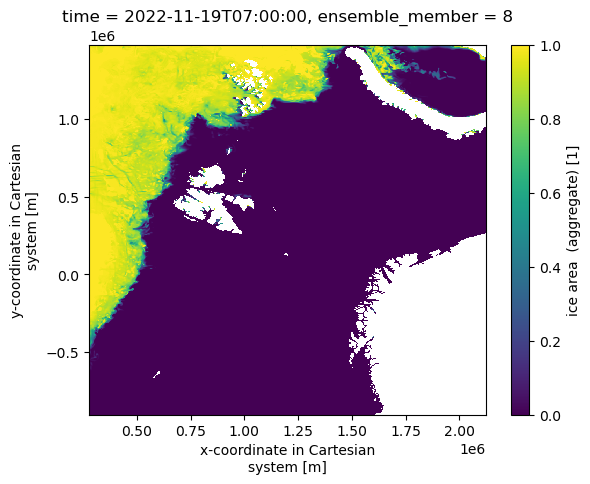

In [15]:
siconc.sel(time=time_period[0],ensemble_member = ensemble_member).plot()

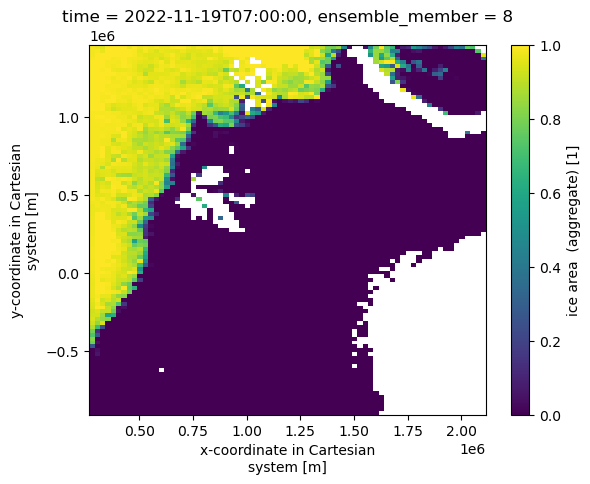

In [16]:
siconc_stp.sel(time=time_period[0]).plot()

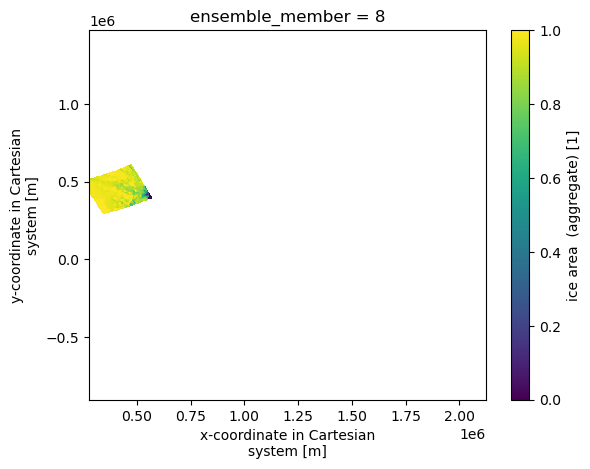

In [17]:
siconc.sel(time=time_period[0],ensemble_member = ensemble_member).where(finalMask>0).plot()

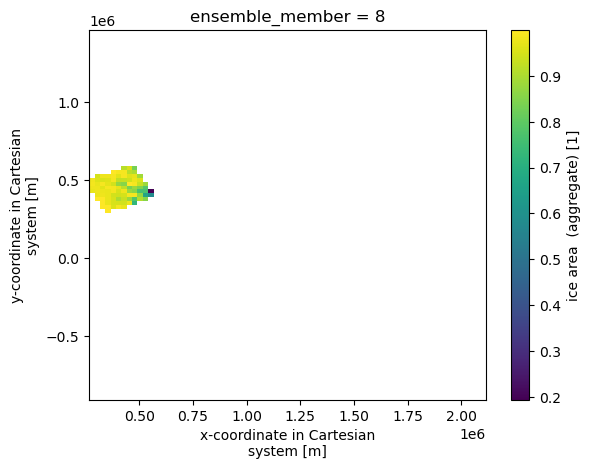

In [18]:
siconc_stp.sel(time=time_period[0]).where(finalMask>0).plot()

In [19]:
print(X_stp.shape, Y_stp.shape, ice_u_stp.shape, time_period.shape)
# Create coordinate arrays  
x_stp, y_stp = np.meshgrid(X_stp, Y_stp)
print(x_stp.shape)
# Turn arrays into vectors
x_stp = x_stp.flatten()
y_stp = y_stp.flatten()

# Store the selected coordinate arrays in lists to collect arrays from different iterationsfor further processing
xx = [x_stp]
yy = [y_stp]


ice_u_stp[0].shape, x_stp.shape,y_stp.shape,  Y_stp.shape, X_stp.shape

(74,) (95,) (27, 95, 74) (27,)
(95, 74)


((95, 74), (7030,), (7030,), (95,), (74,))

In [20]:
#think how to mask out to subset, would .where(finalMask>0) work?
dx_total = 0
dy_total = 0
int_dx = []
int_dy = []

for t in range(1, len(time_period)):
    print(f'{t} hour')
               
    # Clip y_stp and x_stp to ensure they are within the bounds of the coordinate grid
    y_stp = np.clip(y_stp, np.min(Y_stp.data), np.max(Y_stp.data))
    x_stp = np.clip(x_stp, np.min(X_stp.data), np.max(X_stp.data))
               
    # Extract instantaneous velocity data for the hour start and end using polygon mask for area of interest
    u1 = ice_u_stp.sel(time=time_period[t-1])#.where(finalMask>0)
    u2 = ice_u_stp.sel(time=time_period[t])#.where(finalMask>0)
    
    v1 = ice_v_stp.sel(time=time_period[t-1])#.where(finalMask>0)
    v2 = ice_v_stp.sel(time=time_period[t])#.where(finalMask>0)
               
    # Calculate displacement along lon (u) and lat (v) based on mean velovity
    # The first and the last displacemnets are calculated differently based on time difference with the SAR acquisitions
    if t == 1:
        u_displacement = (u2+u1)*(3600-time_diff_start)/2
        v_displacement = (v2+v1)*(3600-time_diff_start)/2
        #print("start", t, u_displacement.values)
    elif t in range(2, len(time_period)-1):
        u_displacement = (u2+u1)*3600/2
        v_displacement = (v2+v1)*3600/2
        #print(t, u_displacement.values)
    elif t == len(time_period)-1:
        u_displacement = (u2+u1)*(3600-time_diff_end)/2
        v_displacement = (v2+v1)*(3600-time_diff_end)/2
        #print("end", t, u_displacement.values)
               
    # Create interpolator object with grid coordinates and corresponded drift values
    ut_interpolator = RegularGridInterpolator((Y_stp.data,X_stp.data), u_displacement.data, bounds_error=False, fill_value = None)
    dx = ut_interpolator((y_stp, x_stp))
    vt_interpolator = RegularGridInterpolator((Y_stp.data,X_stp.data), v_displacement.data, bounds_error=False, fill_value = None)
    dy = vt_interpolator((y_stp, x_stp)) 
    # Calculate new coordinates based on displacement 
    x_stp = x_stp + dx
    y_stp = y_stp + dy
    # Append them to the list
    xx.append(x_stp)
    yy.append(y_stp)
    
    # Append integrated hourly displacement
    int_dx.append(dx)
    int_dy.append(dx)
    #Calculate total integrated drift
    dx_total += dx
    dy_total += dy


1 hour
2 hour
3 hour
4 hour
5 hour
6 hour
7 hour
8 hour
9 hour
10 hour
11 hour
12 hour
13 hour
14 hour
15 hour
16 hour
17 hour
18 hour
19 hour
20 hour
21 hour
22 hour
23 hour
24 hour
25 hour
26 hour


In [21]:
#plot vectors
print(len(int_dx), len(xx)) # why is it 80???
print(len(int_dx[0]), len(xx[0]))

26 27
7030 7030


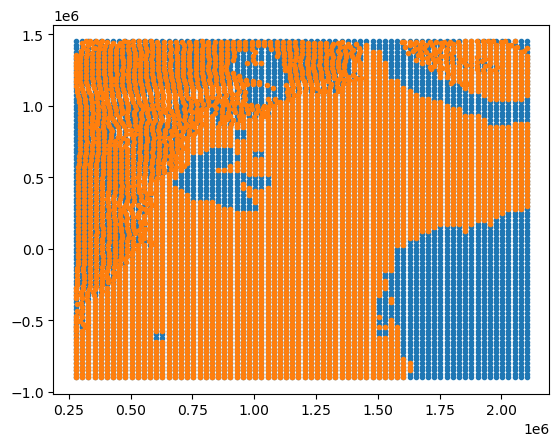

In [22]:
plt.plot(xx[0], yy[0], '.')
#plt.plot(xx[10], yy[10], '.')
plt.plot(xx[26], yy[26], '.')
#plt.xlim([3e5, 6e5])
#plt.ylim([0, 6e5])

plt.show()

Next tasks:
For comparison of model and reference drift
1) compare total inegrated displacements with SAR1-SAR2 displacements (what projection is used for X and Y? - how to export according to subset?)
For warping according to hourly integrated drift
1) convert xx and yy to lon and lat (what is projection?)
2) export stacked xx[0], yy[0], xx[1], yy[1], dx[0], dy[0] to csv file (xx[0], yy[0] are lon1, lat2, xx[1], yy[1] are lon2, lat2
3) apply alignment algorithm

In [ ]:
# Export hourly ingrated drift
# h1 = lon1 (yy[0]), lat1(xx[0], dx, dy

In [182]:
# Create coordinate arrays  
x_stp, y_stp = np.meshgrid(X, Y)
# Turn arrays into vectors and mas out values with low and zero concentration
x_stp = x_stp.flatten()
y_stp = y_stp.flatten()

# Store the selected coordinate arrays in lists to collect arrays from different iterationsfor further processing
xx = [x_stp]
yy = [y_stp]

# Get test data for setting subset mask
u_test = ice_u.sel(time='2022-11-19T08:00:00', ensemble_member = 8)
v_test = ice_v.sel(time='2022-11-19T08:00:00', ensemble_member = 8)
# Create interpolator object with grid coordinates and corresponded drift values
u_interpolator = RegularGridInterpolator((Y,X), u_test)
v_interpolator = RegularGridInterpolator((Y,X), v_test)
# Apply interpolator object as function to calculate interpolated velocity values for new coordinates
# y_stp, x_step correspond to original masked grid coordinated at fist iteration
u_new = u_interpolator((y_stp, x_stp))
v_new = v_interpolator((y_stp, x_stp)) 
# Calculate displacement
dx = u_new*3600
dy = v_new*3600
# Calculate new coordinates  y_stp, x_step for next iteration
x_stp = x_stp + dx
y_stp = y_stp + dy
# Append them to the list
xx.append(x_stp)
yy.append(y_stp)


array([[ 278603.2, -897931.6],
       [ 281103.2, -897931.6],
       [ 283603.2, -897931.6],
       ...,
       [2118603.2, 1472067.6],
       [2121103. , 1472067.6],
       [2123602.8, 1472067.6]], dtype=float32)

In [183]:
#transform lat1, lon1 coordinates to meters
inputEPSG = 4326
outputEPSG = 3996
netcdfEPSG = 3413
crs = osr.SpatialReference()
crs.ImportFromEPSG(inputEPSG)
crsGeo = osr.SpatialReference()
crsGeo.ImportFromEPSG(outputEPSG)
crscdf = osr.SpatialReference()
crscdf.ImportFromEPSG(netcdfEPSG)

trans_cdf = osr.CoordinateTransformation(crscdf, crsGeo)
netcdf_points = trans_cdf.TransformPoints( data )
x_cdf, y_cdf = ( np.array( [elem[0] for elem in netcdf_points] ), np.array( [elem[1] for elem in netcdf_points] ) )

points_cdf2 = np.stack( (x_cdf, y_cdf), axis = 1 )
print(points_cdf2)

header=['X','Y']                 
file_path2 = 'C:\Anna\Test_junk\grid_data_cdf.csv'
with open(file_path2, 'w', newline='') as csv_file:
    out = csv.writer(csv_file, delimiter=',')
    out.writerow(header)
    out.writerows(points_cdf2)

[[-443850.40171397 -843180.15698835]
 [-442058.74168821 -844971.81701411]
 [-440267.08166245 -846763.47703987]
 ...
 [2573304.58895872 -463348.8138168 ]
 [2575096.06981848 -465140.29467656]
 [2576887.55067824 -466931.77553632]]


In [190]:
points2 = np.stack( (x, y), axis = 1 )
points_cdf2.shape, points2.shape

((701311, 2), (701311, 2))

In [187]:
#First, calculate data in right format: lat1, lon1, lat2, lon2
#Export lat and lon data within the mask
lat1 = lat#.where(finalMask>0)
lon1 = lon#.where(finalMask>0)
lat1 = lat1.data.flatten()
lon1 = lon1.data.flatten()

#transform lat1, lon1 coordinates to meters
inputEPSG = 4326
outputEPSG = 3996
crs = osr.SpatialReference()
crs.ImportFromEPSG(inputEPSG)
crsGeo = osr.SpatialReference()
crsGeo.ImportFromEPSG(outputEPSG)
trans = osr.CoordinateTransformation(crs, crsGeo)
points = np.stack( (lat1, lon1), axis = 1 )
pos = trans.TransformPoints( points )
x, y = ( np.array( [elem[0] for elem in pos] ), np.array( [elem[1] for elem in pos] ) )




#conver from coordinates in meters to lat2 lon2   
transback = osr.CoordinateTransformation(crsGeo, crs)
points2 = np.stack( (x, y), axis = 1 )
points2 = transback.TransformPoints(points2)
lat2, lon2  = ( np.array([elem[0] for elem in points2]), np.array([ elem[1] for elem in points2 ]) )
    
header=['X','Y']                 
file_path2 = 'C:\Anna\Test_junk\grid_data_grad.csv'
with open(file_path2, 'w', newline='') as csv_file:
    out = csv.writer(csv_file, delimiter=',')
    out.writerow(header)
    out.writerows(points2)

    

### Getting hourly integrated displacements